## Initial EDA of the Electric Vehicle Charging station data

In [8]:
# libraries
import matplotlib.pyplot as plt
import pandas as pd
import folium


In [3]:

# Load the data to see the first few rows and understand its structure
data_path = '/Users/jaskiratkaur/Documents/HPC/elec-transit-y/data/ev_stations_v1.csv'
ev_data = pd.read_csv(data_path)
ev_data.head()

/var/folders/1b/yw3h_ynn0pq2s09l1hw9zljw0000gn/T/ipykernel_17573/157320901.py:3: DtypeWarning: Columns (27,32,49,51,52,53,54,55,59,61,62) have mixed types. Specify dtype option on import or set low_memory=False.
  ev_data = pd.read_csv(data_path)


,access_code,access_days_time,access_detail_code,cards_accepted,date_last_confirmed,expected_date,fuel_type_code,groups_with_access_code,id,maximum_vehicle_class,...,rd_blends_fr,rd_max_biodiesel_level,nps_unit_name,access_days_time_fr,intersection_directions_fr,bd_blends_fr,groups_with_access_code_fr,ev_pricing_fr,federal_agency,ev_network_ids
0,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2023-11-09,NaN,CNG,Public - Card key at all times,792,HD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
1,public,8am-4pm M-F; Customers must set up a PG&E acco...,KEY_ALWAYS,Proprietor,2023-10-12,NaN,CNG,Public - Card key at all times,798,LD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
2,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2024-01-09,NaN,CNG,Public - Card key at all times,801,HD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
3,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2024-01-09,NaN,CNG,Public - Card key at all times,806,HD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN
4,public,24 hours daily; Customers must set up a PG&E a...,KEY_ALWAYS,Proprietor,2023-10-12,NaN,CNG,Public - Card key at all times,809,MD,...,NaN,NaN,NaN,NaN,NaN,NaN,Public - Carte-clé en tout temps,NaN,NaN,NaN


In [5]:
num_columns = len(ev_data.columns)
print("Number of columns:", num_columns)


Number of columns: 73


The EV charging station dataset contains a lot of columns, about 73 in total, which suggests it has a wide range of attributes. Here are some columns that would be interesting to explore:

**access_code**: Describes the accessibility of the station (e.g., public). 

**access_days_time**: Availability of the station throughout the week. 

**groups_with_access_code**: Access group details. 

**id**: Unique identifier for each station. 

**maximum_vehicle_class**: The maximum vehicle class that can be serviced. 



### Distribution of charging stations by fuel type and their accessibility

In [4]:
# Check for missing data in relevant columns and count the unique values in 'fuel_type_code' and 'access_code'
missing_data = ev_data[['fuel_type_code', 'access_code']].isnull().sum()
fuel_type_distribution = ev_data['fuel_type_code'].value_counts()
access_code_distribution = ev_data['access_code'].value_counts()

missing_data, fuel_type_distribution, access_code_distribution


(fuel_type_code    0
 access_code       0
 dtype: int64,
 fuel_type_code
 ELEC    27681
 E85      1065
 LPG       747
 RD        601
 BD        555
 CNG       481
 HY         95
 LNG        60
 Name: count, dtype: int64,
 access_code
 public     29567
 private     1718
 Name: count, dtype: int64)

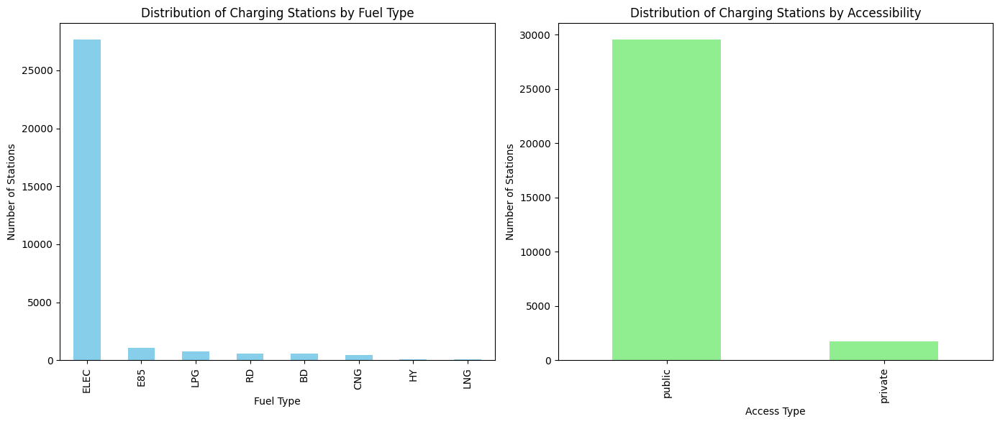

In [10]:

# Setting up the plotting environment
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# Plot for Fuel Type Distribution
fuel_type_distribution.plot(kind='bar', color='skyblue', ax=ax[0])
ax[0].set_title('Distribution of Charging Stations by Fuel Type')
ax[0].set_xlabel('Fuel Type')
ax[0].set_ylabel('Number of Stations')

# Plot for Access Code Distribution
access_code_distribution.plot(kind='bar', color='lightgreen', ax=ax[1])
ax[1].set_title('Distribution of Charging Stations by Accessibility')
ax[1].set_xlabel('Access Type')
ax[1].set_ylabel('Number of Stations')

plt.tight_layout()
plt.show()


### Plotting the location of Charging Stations on a map

In [12]:
latitudes = ev_data['latitude']
longitudes = ev_data['longitude']

# Create a map centered around the average location in the dataset
mean_lat, mean_lon = latitudes.mean(), longitudes.mean()
ev_map = folium.Map(location=[mean_lat, mean_lon], zoom_start=5)

# Add charging station locations to the map
for lat, lon in zip(latitudes, longitudes):
    folium.CircleMarker(
        location=[lat, lon],
        radius=3,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6
    ).add_to(ev_map)

# Show the map
ev_map